In [7]:
import pandas as pd
from sklearn import manifold
import seaborn as sns
import matplotlib.pyplot as plt
import re
import numpy as np

In [2]:
df = pd.read_json("/shared/3/projects/benlitterer/podcastData/contentNetwork/metadata200Topics.json", orient="records", lines=True)

In [4]:
import random

In [5]:
np.random.seed(20)
random.seed(20)

In [6]:
#we want to sample, then project based on the topic vectors 
catList = ["religion", "society", "business", "sports", "news", "comedy", "health"]
sampDf = df[df["category1"].isin(catList)].sample(50000, random_state=40)
tsne = manifold.TSNE()
topicCols = [str(item) for item in range(0, 200)]
topicArr = sampDf[topicCols].to_numpy() 
lowDim = tsne.fit_transform(topicArr)

OpenBLAS warning: precompiled NUM_THREADS exceeded, adding auxiliary array for thread metadata.
To avoid this warning, please rebuild your copy of OpenBLAS with a larger NUM_THREADS setting
or set the environment variable OPENBLAS_NUM_THREADS to 64 or lower


BLAS : Bad memory unallocation! :  640  0x7fa9a4000000


: 

: 

In [7]:
sampDf = pd.concat([pd.DataFrame(lowDim, columns=["d1", "d2"]), sampDf.reset_index()], axis=1)

In [8]:
forDallas = sampDf.sample(25000, random_state=25)
forDallas.reset_index().to_json("/shared/3/projects/benlitterer/podcastData/hostGuestNetwork/topicProjectionData.jsonl", orient="records", lines=True)

ValueError: cannot insert level_0, already exists

In [9]:
sampDf = pd.read_json("/shared/3/projects/benlitterer/podcastData/hostGuestNetwork/topicProjectionData.jsonl", orient="records", lines=True)

In [10]:
catList = ["religion", "society", "business", "sports", "news", "comedy", "health"]

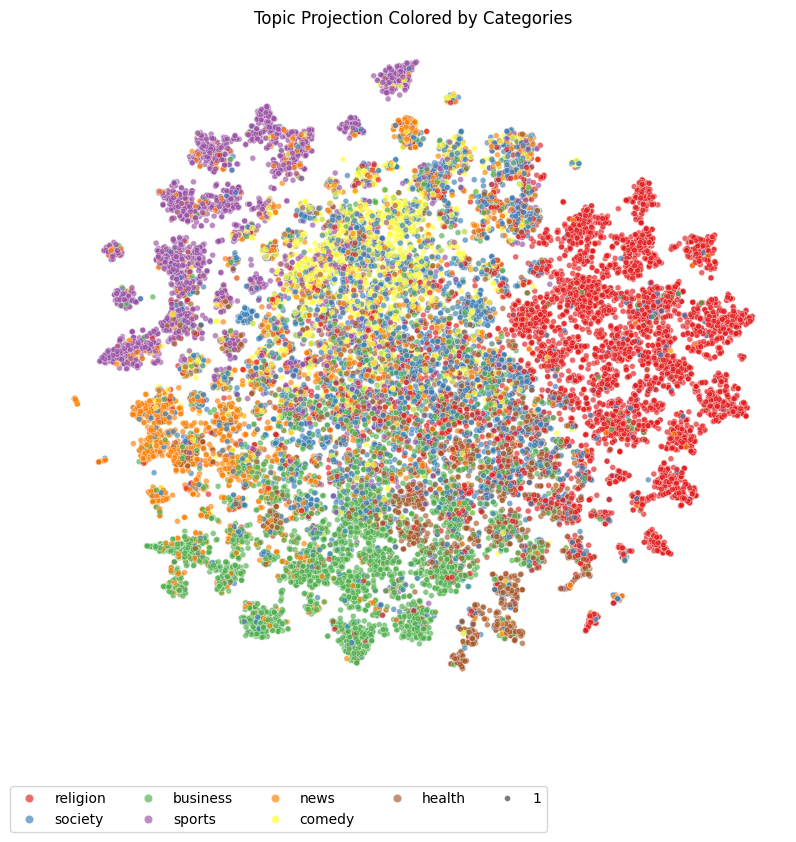

In [11]:
#the first thing we want to do is just get a really nice, high resolution version of the category figure!
#first thing to do is just to make a very simple figure colored by topics 
fig, ax = plt.subplots(1, 1, figsize=(8, 8.5))
pal = ['#e41a1c','#377eb8','#4daf4a','#984ea3','#ff7f00','#ffff33','#a65628']
sns.scatterplot(data=sampDf.sample(25000, random_state=25), x="d1", y="d2", hue="category1", palette=pal, hue_order=catList, size=1, alpha=.65, ax=ax, rasterized=True)

ax.set_title("Topic Projection Colored by Categories")
ax.legend(loc="lower left", bbox_to_anchor=(-.05, -.21),ncol=5)

plt.axis("off")
plt.tight_layout()
plt.savefig("/shared/3/projects/benlitterer/podcastData/figures/potentialPubFigures/topicProjections400.png", dpi=400, bbox_inches="tight")
plt.savefig("/shared/3/projects/benlitterer/podcastData/figures/potentialPubFigures/topicProjections400.pdf", dpi=400, bbox_inches="tight")
plt.savefig("/shared/3/projects/benlitterer/podcastData/figures/potentialPubFigures/topicProjections600.png", dpi=600, bbox_inches="tight")
plt.savefig("/shared/3/projects/benlitterer/podcastData/figures/potentialPubFigures/topicProjections600.pdf", dpi=600, bbox_inches="tight")


In [22]:
#we want to find what topics are clustered! 
#we may need to drop filler topics! 
def assignCat(inRow, inCols): 
    topCat = inCols[np.argmax(inRow)]
    return topCat

sampDf["topTopicProp"] = sampDf.loc[:,topicCols].apply(max, axis=1)
sampDf["topTopic"] = sampDf.loc[:,topicCols].apply(assignCat, args=[topicCols], axis=1)

In [23]:
#get topic descriptions so we can interpret!
topicKeysPath = "/shared/3/projects/benlitterer/podcastData/topicModelling/200/transcripts/topic_keys.txt"
topicKeys = pd.read_csv(topicKeysPath, sep="\t", names=["topicNum", "topicProp", "topicWords"])

In [16]:
#topicKeys.loc[topicKeys["topicNum"] == int(currTopic), "topicWords"]

NameError: name 'currTopic' is not defined

/tmp/ipykernel_1147959/2592594604.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  currDf["isCurrTopic"] = currDf["topTopic"] == currTopic
/tmp/ipykernel_1147959/2592594604.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  currDf["isCurrTopic"] = currDf["topTopic"] == currTopic
/tmp/ipykernel_1147959/2592594604.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation

/tmp/ipykernel_1147959/2592594604.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  currDf["isCurrTopic"] = currDf["topTopic"] == currTopic
/tmp/ipykernel_1147959/2592594604.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  currDf["isCurrTopic"] = currDf["topTopic"] == currTopic
/tmp/ipykernel_1147959/2592594604.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation

IndexError: list index out of range

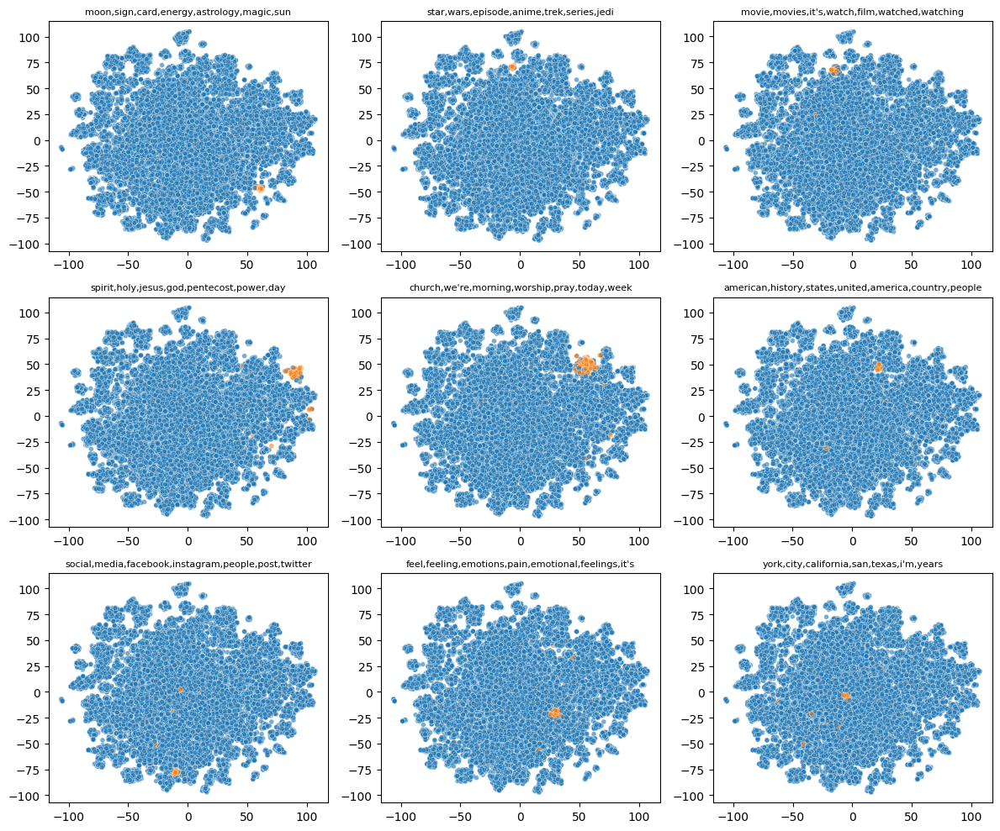

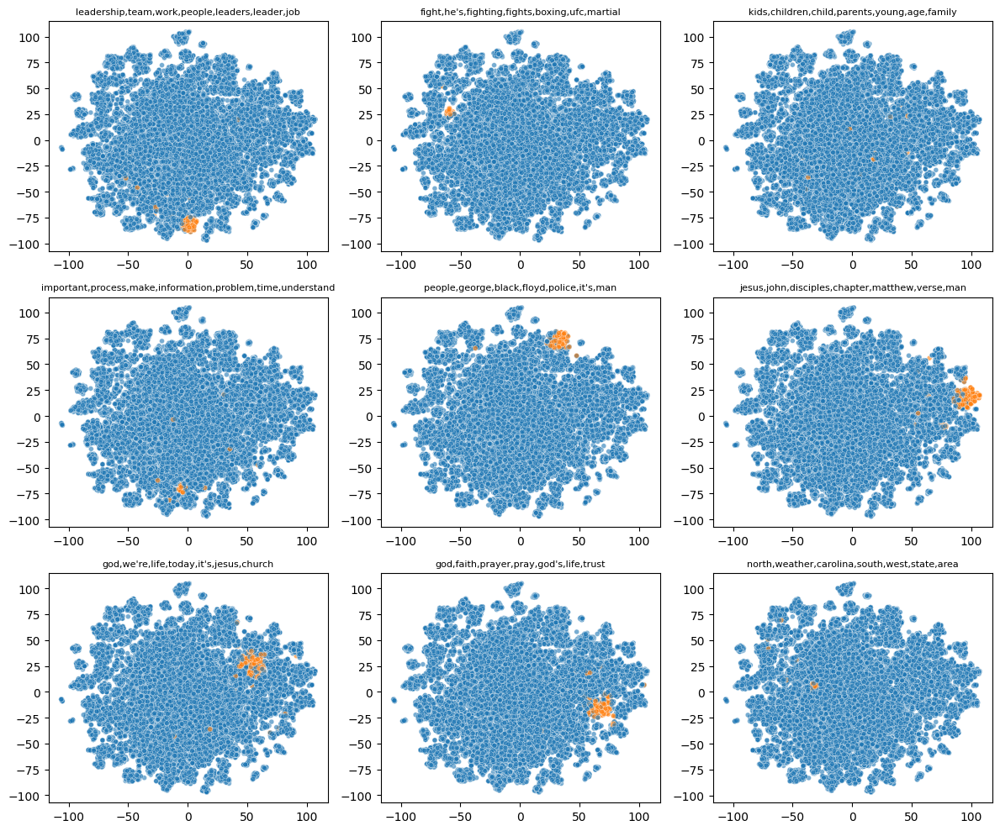

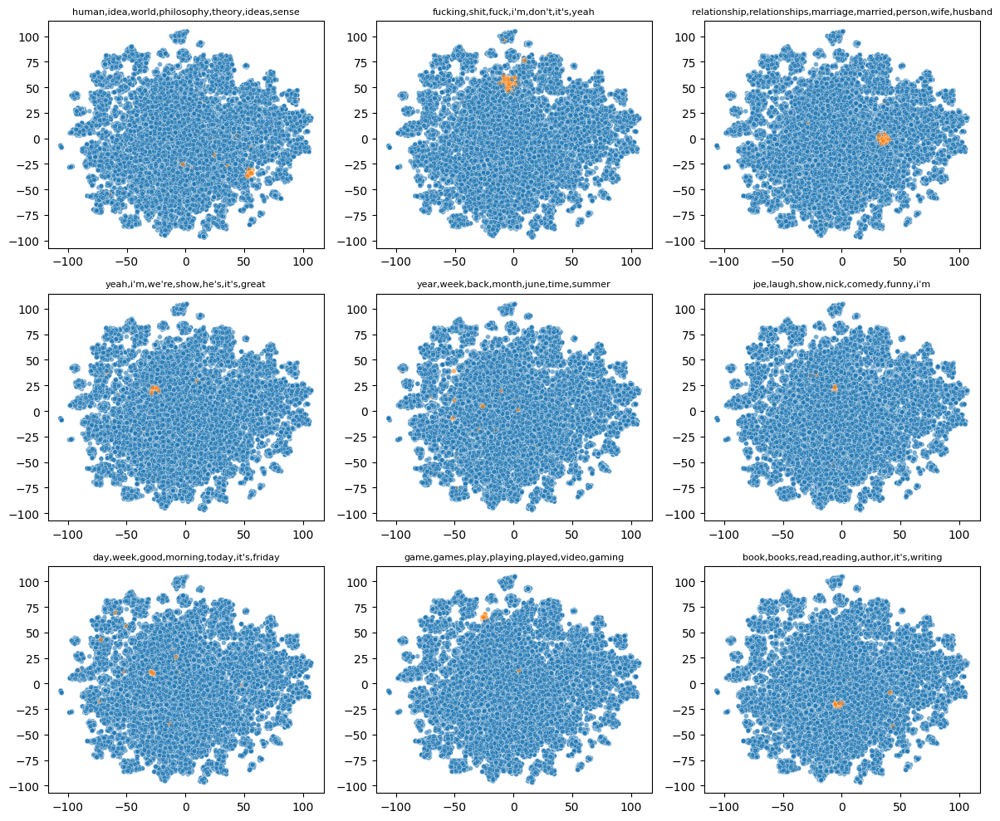

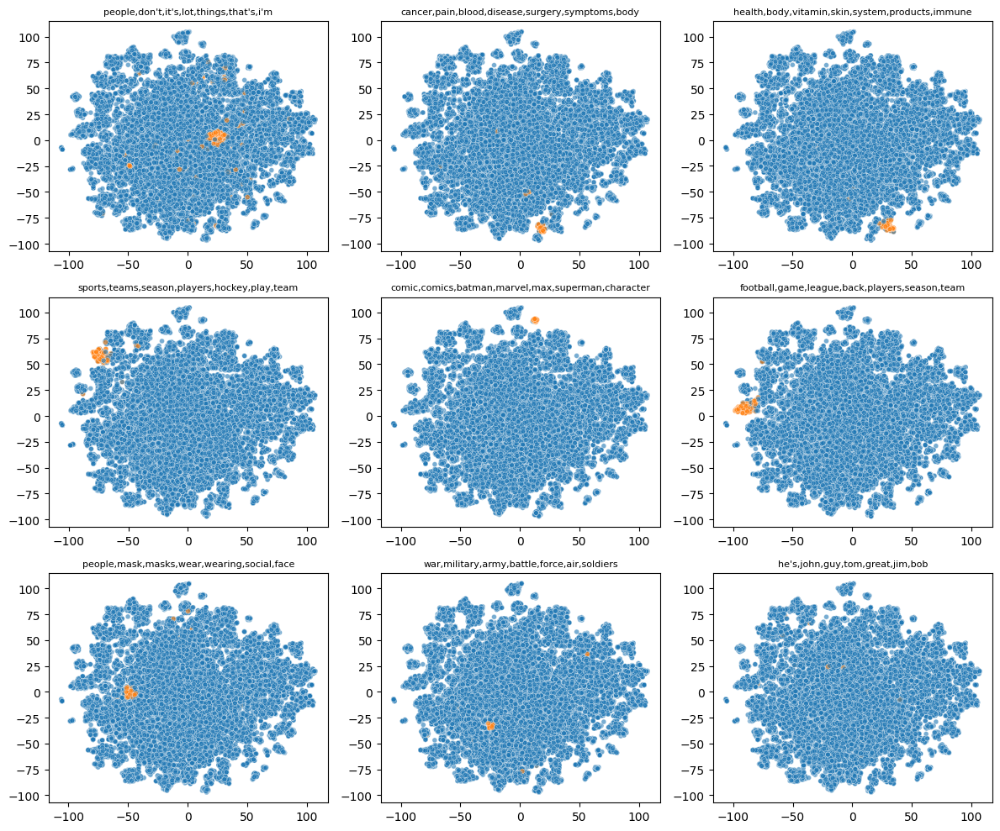

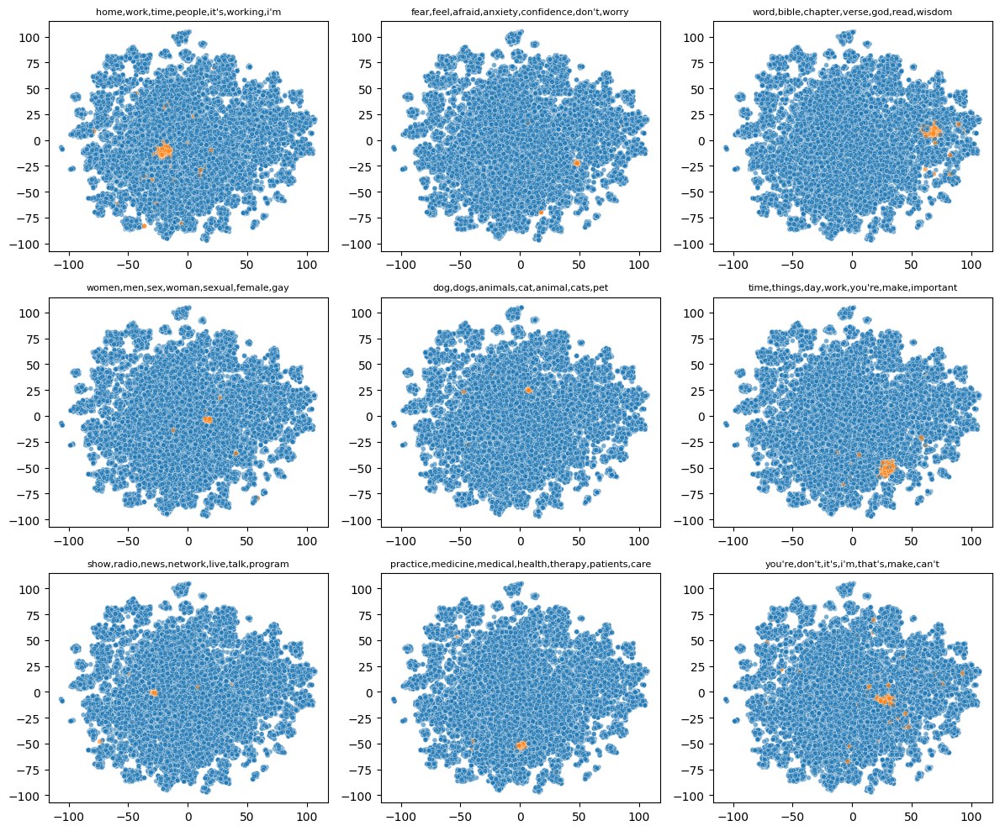

...

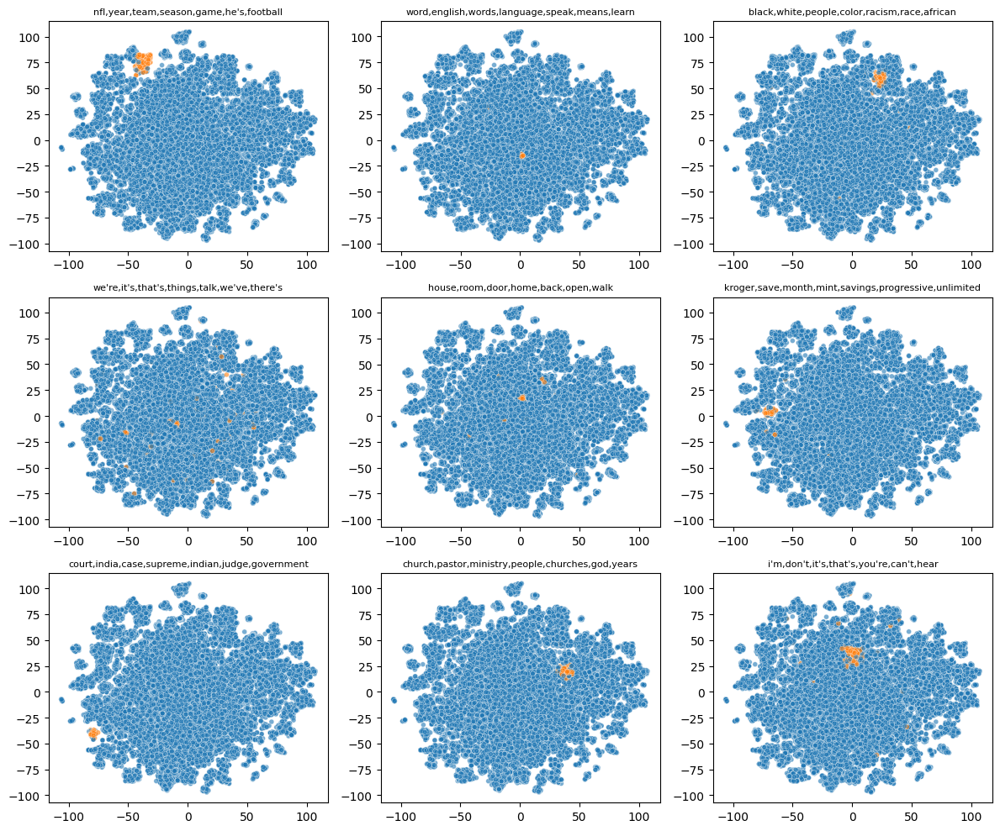

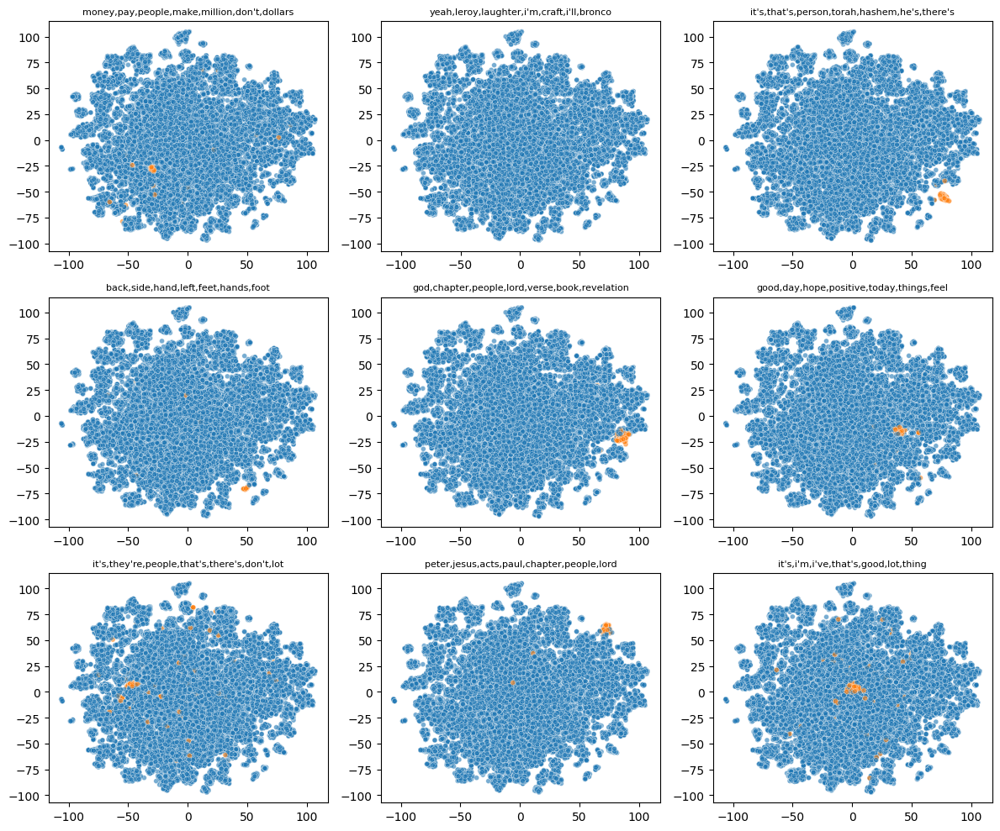

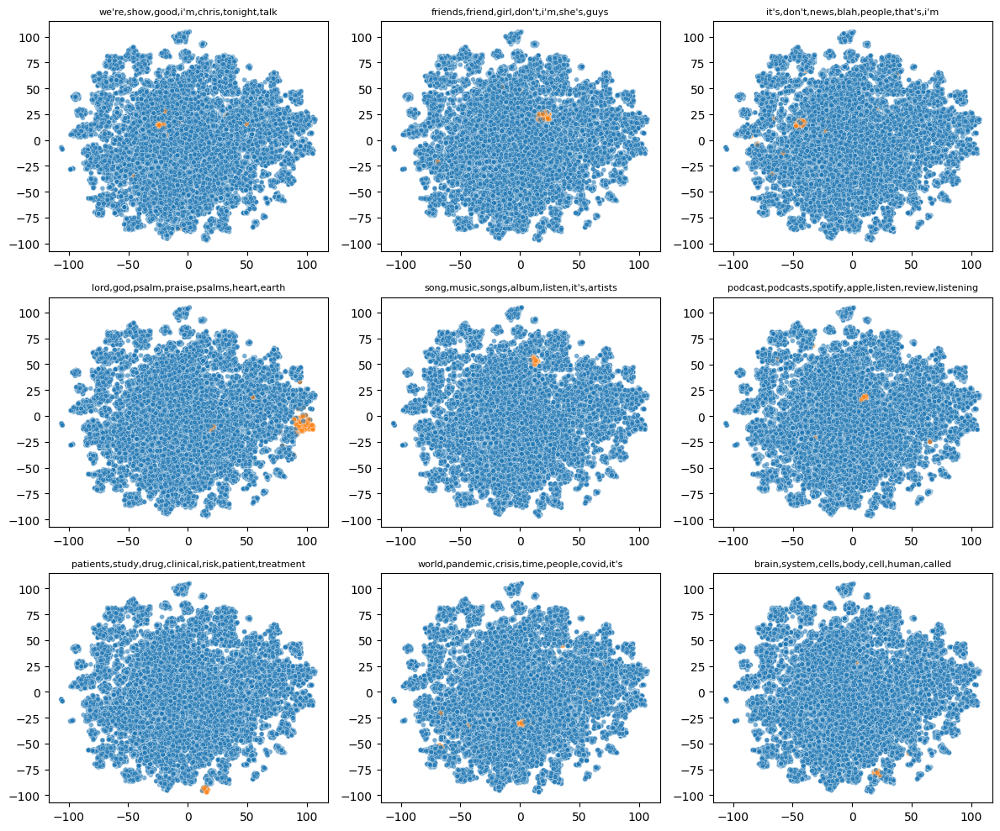

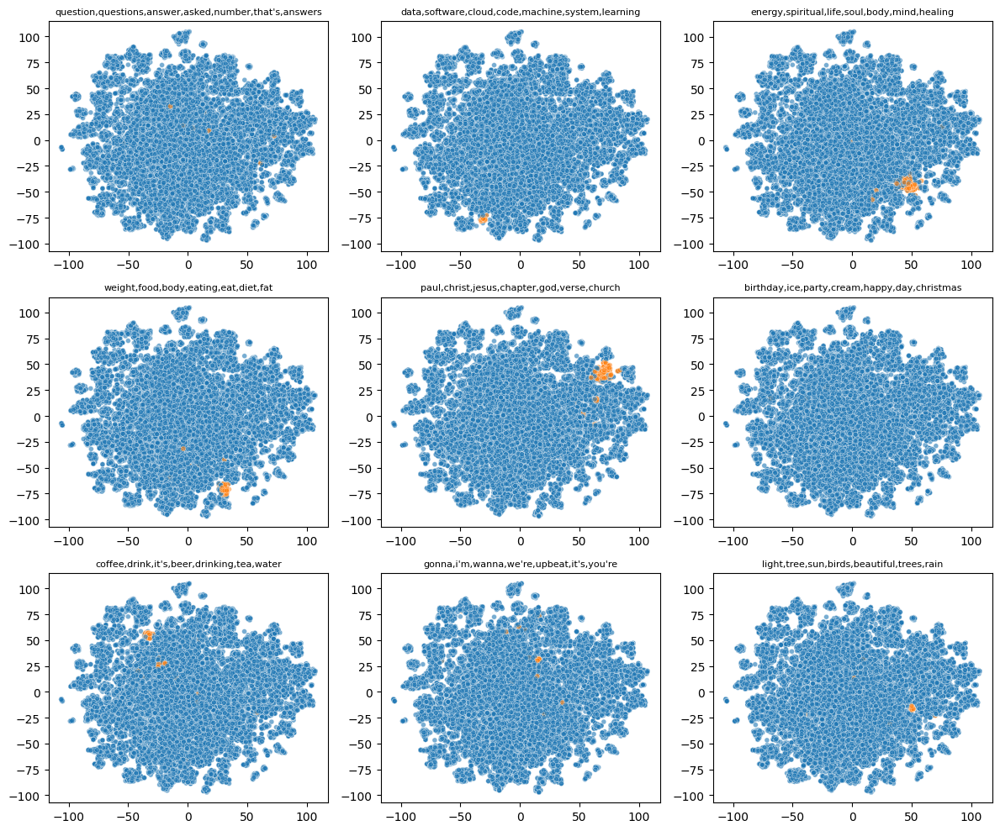

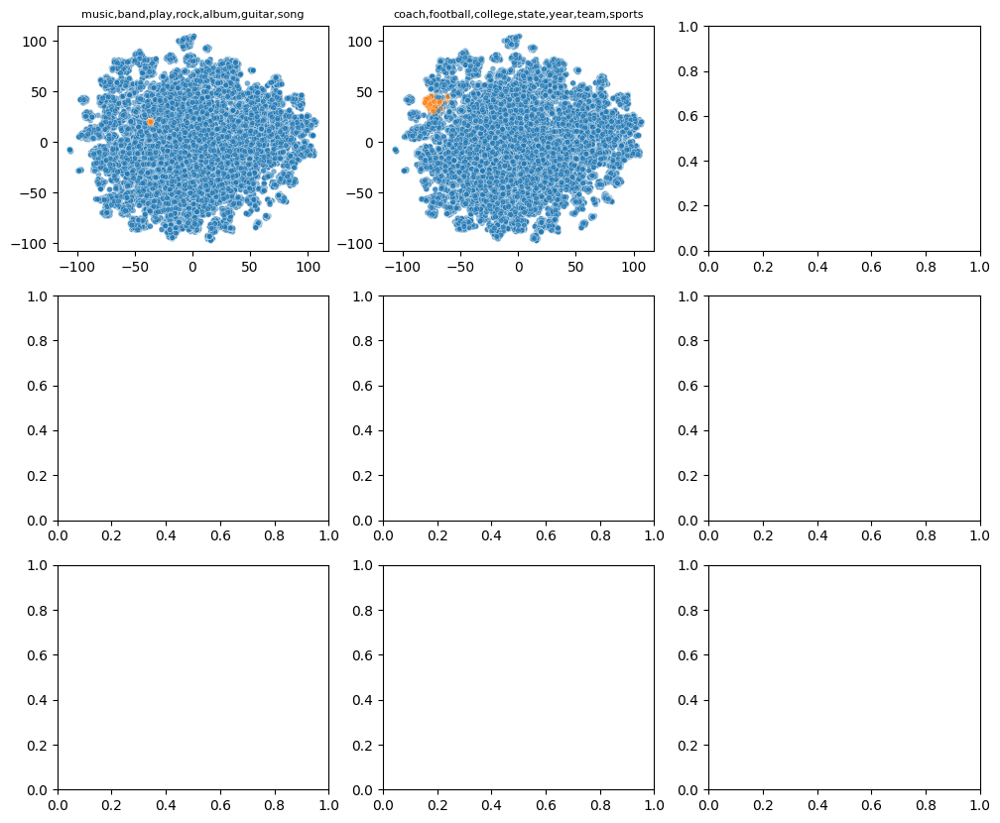

In [24]:
#we want to plot but highlighted by each category 
ROWS=3
COLUMNS=3
topicCounter = 0

while topicCounter < len(topicCols): 
    fig, axs = plt.subplots(ROWS, COLUMNS, figsize=(12, 10)) 
    for i in range(ROWS): 
        for j in range(COLUMNS): 
            currTopic = topicCols[topicCounter]
            currWords = topicKeys.loc[topicKeys["topicNum"] == int(currTopic), "topicWords"].item()
            currWords = ",".join(currWords.split()[:7])
            currDf = sampDf[[currTopic] + ["d1", "d2", "topTopic"]] 
            currDf["isCurrTopic"] = currDf["topTopic"] == currTopic
            sns.scatterplot(currDf.sample(25000), x="d1", y="d2", hue="isCurrTopic", alpha=.6, size=1, ax=axs[i,j])
            axs[i,j].set_xlabel("")
            axs[i,j].set_ylabel("")
            axs[i,j].set_title(currWords, size=8)
            axs[i,j].get_legend().remove() 
            topicCounter += 1

            if topicCounter >= len(topicCols): 
                break 
            
    plt.tight_layout() 
    plt.savefig(f"/shared/3/projects/benlitterer/podcastData/figures/topicClusterFigures/200_50000/clusterFig{topicCounter}.png", bbox_inches="tight")

In [50]:
#we want to get the degree of concentration of topics within each category 
from scipy.stats import entropy 

#get the distribution of categories across each top topic 
#get top topic for each podcast 
topDf = df[["category1"] + topicCols]
topDf["topTopic"] = topDf.loc[:,topicCols].apply(assignCat, args=[topicCols], axis=1)

/tmp/ipykernel_939679/3146900172.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  topDf["topTopic"] = topDf.loc[:,topicCols].apply(assignCat, args=[topicCols], axis=1)


In [75]:
#get distribution of top topic
topicSums = topDf["category1"].value_counts().head(20).reset_index()
topCats = topicSums["category1"]

topicDist = [count/sum(topicSums["count"]) for count in topicSums["count"]]

In [130]:
from collections import Counter

def getDist(inList): 
    c = Counter(inList)
    totalCount = c.total() 
    outDist = []

    #for each topic, get the the count then divide by the total counts to normalize into 
    #probability distribution 
    for topic in topCats: 
        if topic in c: 
            outDist.append(c[topic]/totalCount)
        else: 
            outDist.append(0)
        
    return outDist 

catDists = topDf[["category1", "topTopic"]].groupby("topTopic").agg(getDist)

catDists["entropy"] = catDists["category1"].apply(lambda x: entropy(x))
catDists["relativeEntropy"] = catDists["category1"].apply(lambda x: entropy(x, topicDist))
catDists = catDists.reset_index() 
catDists["topTopic"] = catDists["topTopic"].astype(int)

catDists = pd.merge(catDists.rename(columns={"topTopic":"topicNum"}), topicKeys, on="topicNum", how="inner")
catDists["category1"] = catDists["category1"].apply(lambda x: sorted(x, reverse=True))

topicCounts = topDf[["category1", "topTopic"]].groupby("topTopic").agg(lambda x: [tup[0] for tup in Counter(x).most_common(4)])
topicCounts = topicCounts.reset_index().rename(columns={"topTopic":"topicNum", "category1":"topCategories"})
topicCounts["topicNum"] = topicCounts["topicNum"].astype(int)

catDists = pd.merge(topicCounts, catDists, on="topicNum")

In [131]:
catDists.sort_values("entropy", ascending=False).iloc[0:20]

,topicNum,topCategories,category1,entropy,relativeEntropy,topicProp,topicWords
154,58,"[business, education, society, health]","[0.14626490897677338, 0.12010880937434609, 0.1...",2.674982,0.078845,0.05834,show free podcast website email check you're e...
96,185,"[society, comedy, education, business]","[0.16283571255746432, 0.11879990321800145, 0.0...",2.610976,0.124053,0.03973,podcast podcasts spotify apple listen review l...
75,166,"[society, comedy, education, religion]","[0.16822129302026376, 0.13348343518816339, 0.0...",2.585587,0.210807,0.05127,house room door home back open walk front put ...
164,67,"[business, society, arts, education]","[0.18264342774146697, 0.11619462599854757, 0.0...",2.584036,0.109489,0.07625,sort it's that's there's bit lot things kind y...
168,70,"[sports, society, business, leisure]","[0.14536256323777402, 0.12613827993254637, 0.1...",2.573967,0.111425,0.06769,guys i'm we're it's yeah hey excited good that...
28,123,"[society, business, education, health]","[0.16183338763983926, 0.12729444987509503, 0.1...",2.569631,0.094532,0.11683,kind it's lot things bit yeah that's stuff i'm...
91,180,"[business, sports, religion, society]","[0.12872421695951108, 0.12624140565317035, 0.1...",2.567418,0.062188,0.06360,we're show good i'm chris tonight talk great i...
59,151,"[sports, society, comedy, business]","[0.13813256325632564, 0.13441969196919692, 0.1...",2.567014,0.167305,0.05450,it's bit i've yeah i'm we've sort you've lockd...
43,137,"[society, education, business, comedy]","[0.2034904970760234, 0.13313230994152048, 0.08...",2.561375,0.126215,0.10796,episode podcast i'm talk episodes back week li...
114,21,"[sports, business, comedy, society]","[0.1648578811369509, 0.14599483204134367, 0.09...",2.559324,0.120304,0.06239,yeah i'm we're show he's it's great mike podca...


In [132]:
catDists.to_csv("/shared/3/projects/benlitterer/podcastData/figures/topicClusterFigures/topicCategoryEntropies.tsv", sep="\t")

In [ ]:
pd.merge(topTopics, catDists, on="topicNum")

In [196]:
#topCats = list(sampDf["category2"].value_counts().index)
#get the top categories within each subcategory? 
#topics within subcategories 
cats = ["religion", "society", "business", "sports", "news", "comedy", "health"]
secondCats = []
#what are the big categories within each of these? 
for cat in cats: 
    top2 = list(sampDf[sampDf["category1"] == cat].value_counts("category2").index)[:3]
    print(top2)
    print("---------")
    secondCats += top2

['spirituality']
---------
['culture']
---------
['entrepreneurship', 'investing', 'careers']
---------


['football', 'basketball', 'wrestling']
---------
['politics', 'entertainment', 'commentary']
---------
['interviews', 'improv', 'society']
---------
['fitness', 'alternative', 'sexuality']
---------


NameError: name 'sampDf' is not defined

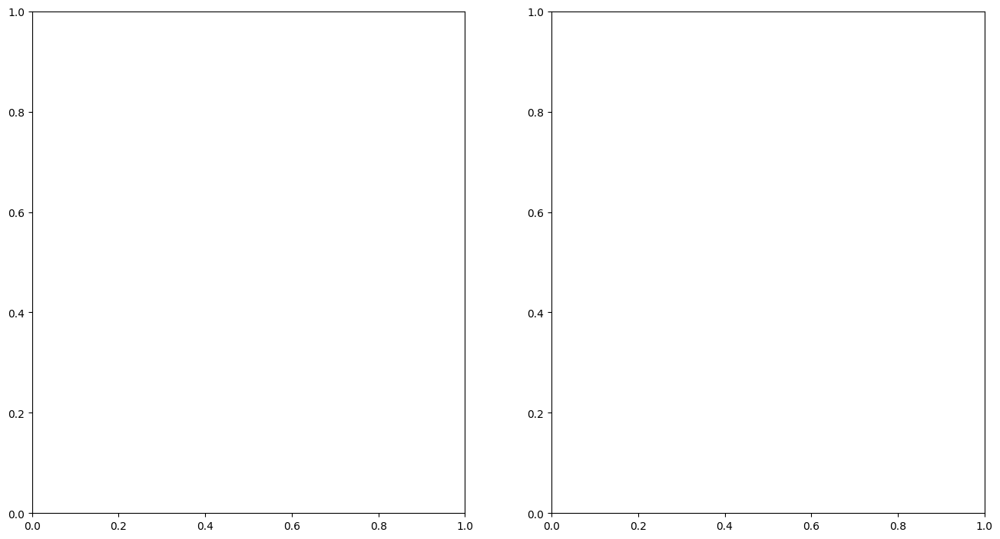

In [5]:
#first thing to do is just to make a very simple figure colored by topics 
fig, ax = plt.subplots(1, 2, figsize=(16, 8.5))
pal = ['#e41a1c','#377eb8','#4daf4a','#984ea3','#ff7f00','#ffff33','#a65628']
sns.scatterplot(data=sampDf.sample(25000), x="d1", y="d2", hue="category1", palette=pal, hue_order=catList, size=1, alpha=.8, ax=ax[0])
ax[0].set_title("Topic Projection Colored by Primary Categories")
ax[0].legend(loc="lower left", bbox_to_anchor=(-.05, -.21),ncol=5)


secondPal = [['#e41a1c'],
['#377eb8'],
['#20391e', '#4daf4a'],
['#331f36', '#984ea3'],
['#794012', '#ff7f00'],
['#ffff33', '#787724'],
['#a65628', '#382013']]
secondPal = sum(secondPal, [])

secondCats = ["spirituality", "entrepreneurship", "investing", "careers", "football", "basketball", "wrestling", 'politics', 'entertainment', 'commentary']
secondPal = [
['#e41a1c'],
['#20391e', '#377133', '#4daf4a'],
['#331f36', '#984ea3','#63366a'],
['#512c10', '#a45411', '#ff7f00'],
]
secondPal = sum(secondPal, [])

sns.scatterplot(data=sampDf[sampDf["category2"].isin(secondCats)], x="d1", y="d2", hue="category2", palette=secondPal, hue_order=secondCats, size=1, alpha=.8, ax=ax[1])
ax[1].set_title("Topic Projection Colored by Subcategories")
ax[1].legend(loc="lower right", bbox_to_anchor=(1.05, -.25),ncol=4)
plt.tight_layout()
plt.savefig("/shared/3/projects/benlitterer/podcastData/figures/potentialPubFigures/topicProjections.png", dpi=500, bbox_inches="tight")

Text(0.5, 1.0, "After Floyd's Death")

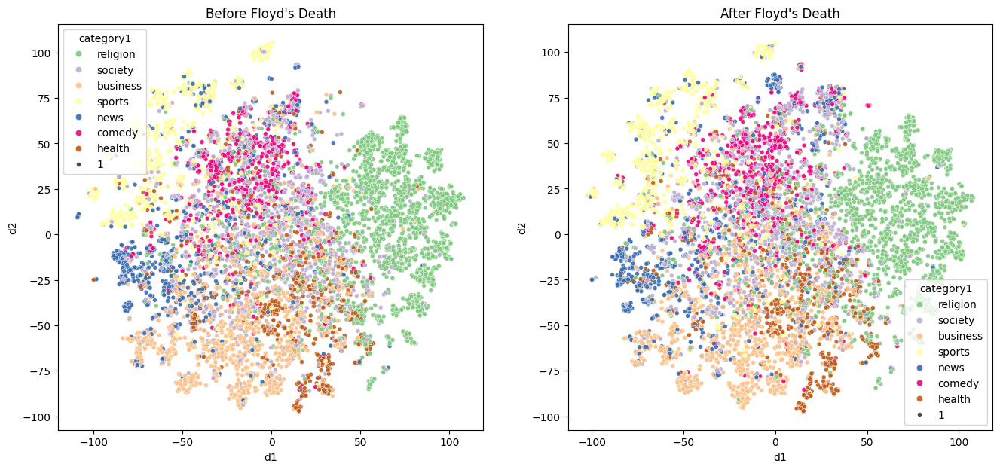

In [109]:
fig, axs = plt.subplots(1, 2, figsize=(16, 7))
pal = ['#7fc97f','#beaed4','#fdc086','#ffff99','#386cb0','#f0027f','#bf5b17']
beforeFloyd = sampDf[(sampDf["cleanDatesLoc"] < "2020-05-25") & (sampDf["cleanDatesLoc"] > "2020-05-17")]
sns.scatterplot(data=beforeFloyd, x="d1", y="d2", hue="category1", palette=pal, hue_order=catList, size=1, alpha=.9, ax=axs[0])
axs[0].set_title("Before Floyd's Death")

afterFloyd = sampDf[(sampDf["cleanDatesLoc"] > "2020-05-25") & (sampDf["cleanDatesLoc"] < "2020-06-02")]
pal = ['#7fc97f','#beaed4','#fdc086','#ffff99','#386cb0','#f0027f','#bf5b17']
sns.scatterplot(data=afterFloyd, x="d1", y="d2", hue="category1", palette=pal, hue_order=catList, size=1, alpha=.9, ax=axs[1])
axs[1].set_title("After Floyd's Death")

In [111]:
racismList = ["racism", "racial justice", "police brutality", "police violence", "black people", " black person", "black lives matter"]
racismRE = f'({"|".join(racismList)})'
beforeFloyd["mentionsRace"] = beforeFloyd["transcript"].apply(lambda x: re.search(racismRE, x.lower()) != None)

afterFloyd["mentionsRace"] = afterFloyd["transcript"].apply(lambda x: re.search(racismRE, x.lower()) != None)

/tmp/ipykernel_4141968/2031647148.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  beforeFloyd["mentionsRace"] = beforeFloyd["transcript"].apply(lambda x: re.search(racismRE, x.lower()) != None)
/tmp/ipykernel_4141968/2031647148.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  afterFloyd["mentionsRace"] = afterFloyd["transcript"].apply(lambda x: re.search(racismRE, x.lower()) != None)


Text(0.5, 1.0, "After Floyd's Death")

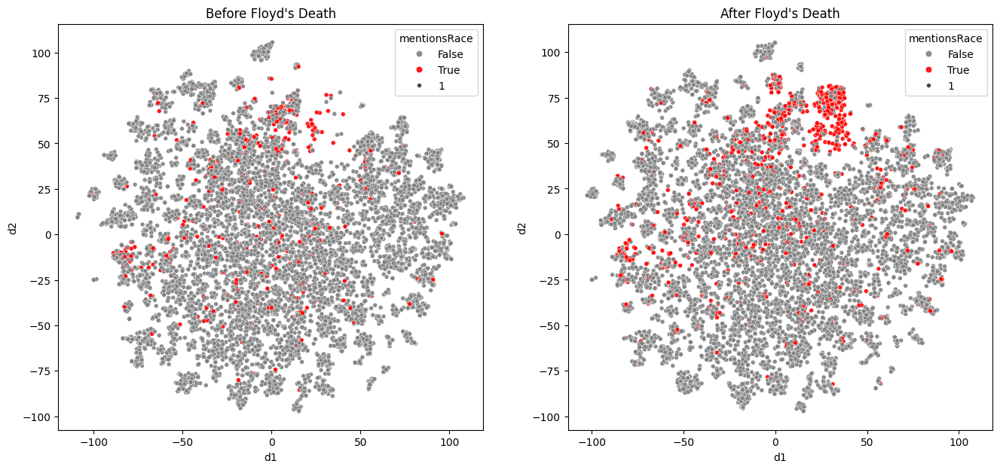

In [112]:

fig, axs = plt.subplots(1, 2, figsize=(16, 7))
pal = ['#7fc97f','#beaed4','#fdc086','#ffff99','#386cb0','#f0027f','#bf5b17']
sns.scatterplot(data=beforeFloyd, x="d1", y="d2", hue="mentionsRace", palette=["grey", "red"], size=1, alpha=.9, ax=axs[0])
axs[0].set_title("Before Floyd's Death")

sns.scatterplot(data=afterFloyd, x="d1", y="d2", hue="mentionsRace", palette=["grey", "red"], size=1, alpha=.9, ax=axs[1])
axs[1].set_title("After Floyd's Death")

In [74]:
#what if we do seperate embeddings for before and after? 
#we want to sample, then project based on the topic vectors 
catList = ["religion", "society", "business", "sports", "news", "comedy", "health"]
sampDf = df[df["category1"].isin(catList)].sample(50000, random_state=40)
sampDf["cleanDatesLoc"] = pd.to_datetime(sampDf["cleanDatesLoc"], unit="ms")

beforeSamp = sampDf[(sampDf["cleanDatesLoc"] < "2020-05-25") & (sampDf["cleanDatesLoc"] > "2020-05-17")]
afterSamp = sampDf[(sampDf["cleanDatesLoc"] > "2020-05-25") & (sampDf["cleanDatesLoc"] < "2020-06-02")]

tsne = manifold.TSNE()
topicCols = [str(item) for item in range(0, 200)]

topicArr = beforeSamp[topicCols].to_numpy() 
beforeLD = tsne.fit_transform(topicArr)

topicArr = afterSamp[topicCols].to_numpy() 
afterLD = tsne.fit_transform(topicArr)


In [75]:
beforeSamp = pd.concat([pd.DataFrame(beforeLD, columns=["d1", "d2"]), beforeSamp.reset_index()], axis=1)
afterSamp = pd.concat([pd.DataFrame(afterLD, columns=["d1", "d2"]), afterSamp.reset_index()], axis=1)

Text(0.5, 1.0, "Week After Floyd's Death")

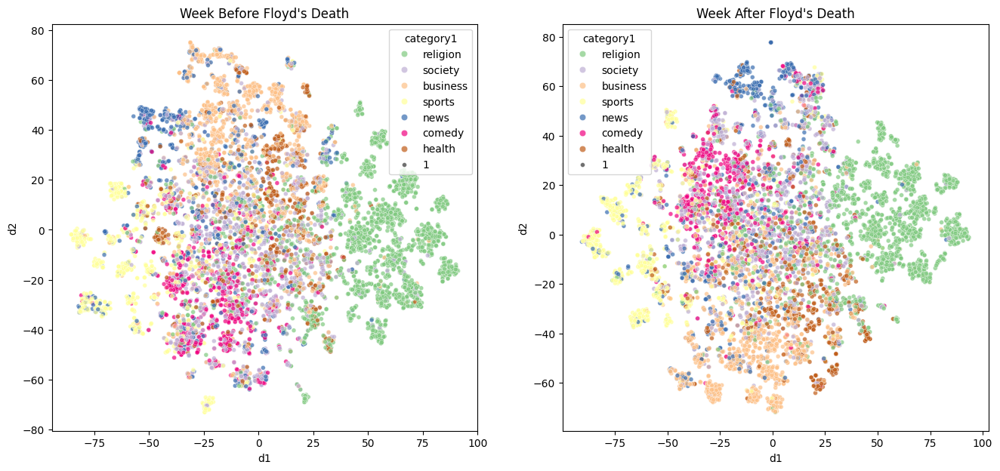

In [115]:
fig, axs = plt.subplots(1, 2, figsize=(16, 7))
pal = ['#7fc97f','#beaed4','#fdc086','#ffff99','#386cb0','#f0027f','#bf5b17']

sns.scatterplot(data=beforeSamp, x="d1", y="d2", hue="category1", palette=pal, hue_order=catList, size=1, alpha=.7, ax=axs[0])
axs[0].set_title("Week Before Floyd's Death")

sns.scatterplot(data=afterSamp, x="d1", y="d2", hue="category1", palette=pal, hue_order=catList, size=1, alpha=.7, ax=axs[1])
axs[1].set_title("Week After Floyd's Death")

In [94]:
racismList = ["racism", "racial justice", "police brutality", "police violence", "black people", " black person", "black lives matter"]
racismRE = f'({"|".join(racismList)})'
racismRE

'(racism|racial justice|police brutality|police violence|black people| black person|black lives matter)'

In [95]:
beforeSamp.head()
beforeSamp["mentionsRace"] = beforeSamp["transcript"].apply(lambda x: re.search(racismRE, x.lower()) != None)
afterSamp["mentionsRace"] = afterSamp["transcript"].apply(lambda x: re.search(racismRE, x.lower()) != None)

Text(0.5, 1.0, "Week After Floyd's Death")

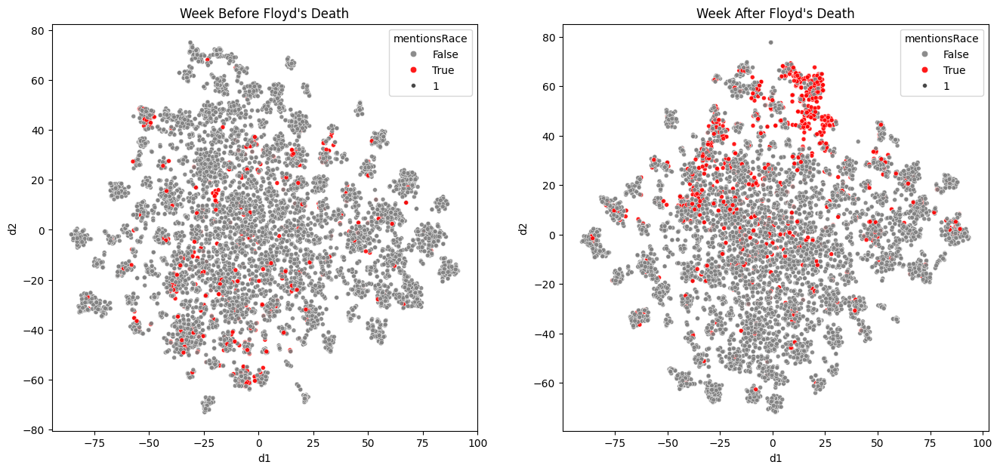

In [98]:
fig, axs = plt.subplots(1, 2, figsize=(16, 7))
pal = ['#7fc97f','#beaed4','#fdc086','#ffff99','#386cb0','#f0027f','#bf5b17']
sns.scatterplot(data=beforeSamp, x="d1", y="d2", hue="mentionsRace", palette=["grey", "red"], size=1, alpha=.9, ax=axs[0])
axs[0].set_title("Week Before Floyd's Death")

sns.scatterplot(data=afterSamp, x="d1", y="d2", hue="mentionsRace", palette=["grey", "red"], size=1, alpha=.9, ax=axs[1])
axs[1].set_title("Week After Floyd's Death")

In [101]:
beforeSamp.head()
#beforeSamp["mentionsFloyd"] = beforeSamp["transcript"].apply(lambda x: re.search(racismRE, x.lower()) != None)
afterSamp["mentionsFloyd"] = afterSamp["transcript"].apply(lambda x: re.search("george floyd", x.lower()) != None)

Text(0.5, 1.0, "Week After Floyd's Death")

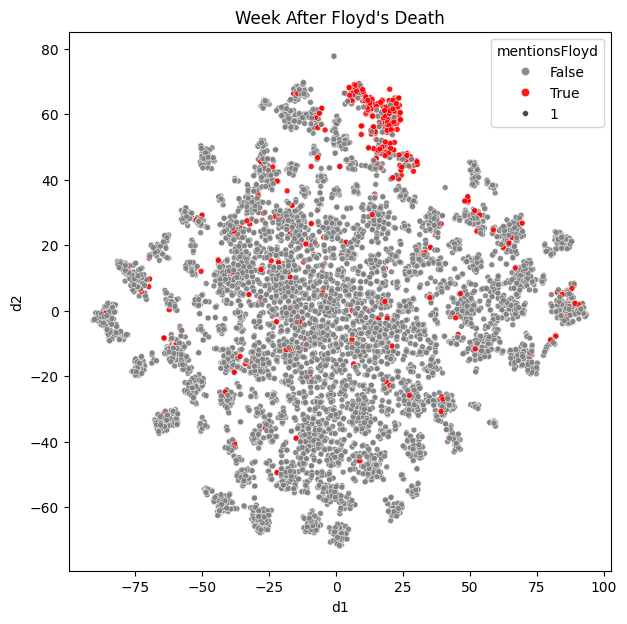

In [113]:
fig, axs = plt.subplots(1, 1, figsize=(7, 7))
sns.scatterplot(data=afterSamp, x="d1", y="d2", hue="mentionsFloyd", palette=["grey", "red"], size=1, alpha=.9, ax=axs)
axs.set_title("Week After Floyd's Death")

In [123]:
import numpy as np

In [128]:
RJCols = [str(item) for item in [5, 13, 57, 69, 159, 164]]

#figure out if any of the racial justice topics have over 5% of their topic 
#and figure out which topic is the highest 
beforeSamp["greatestRJTopicProp"] = beforeSamp[RJCols].apply(max, axis=1)
beforeSamp["greatestRJTopic"] = beforeSamp[RJCols].apply(lambda row: RJCols[np.argmax(row)], axis=1)

afterSamp["greatestRJTopicProp"] = afterSamp[RJCols].apply(max, axis=1)
afterSamp["greatestRJTopic"] = afterSamp[RJCols].apply(lambda row: RJCols[np.argmax(row)], axis=1)

In [132]:
beforeSamp["greatestRJTopicClean"] = beforeSamp.apply(lambda row: row["greatestRJTopic"] if row["greatestRJTopicProp"] > .05 else "None", axis=1)
afterSamp["greatestRJTopicClean"] = afterSamp.apply(lambda row: row["greatestRJTopic"] if row["greatestRJTopicProp"] > .05 else "None", axis=1)

In [137]:
'''
5- American History 
13 - general george floyd 
57 - BLM 
63 - crime 
69 - more general society and culture 
159 - focus is more on policing and minneapolis 
164 - more about racism as a concept 
'''

['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']

In [147]:
RJCols

['5', '13', '57', '69', '159', '164']

In [148]:
mapDict = dict(zip(["None"] + RJCols, ["None", "American History", "George Floyd", "BLM", "Crime", "Society/Culture", "Policing/Minneapolis", "Racism"]))
beforeSamp["greatestTopicLab"] = beforeSamp["greatestRJTopicClean"].map(mapDict)
afterSamp["greatestTopicLab"] = afterSamp["greatestRJTopicClean"].map(mapDict)

/tmp/ipykernel_4141968/980974924.py:3: UserWarning: The palette list has more values (8) than needed (7), which may not be intended.
  sns.scatterplot(data=beforeSamp, x="d1", y="d2", hue="greatestTopicLab", palette=["grey"] + pal, size=1, alpha=.9, ax=axs[0])
/tmp/ipykernel_4141968/980974924.py:6: UserWarning: The palette list has more values (8) than needed (7), which may not be intended.
  sns.scatterplot(data=afterSamp, x="d1", y="d2", hue="greatestTopicLab", palette=["grey"] + pal, size=1, alpha=.9, ax=axs[1])


Text(0.5, 1.0, "Week After Floyd's Death")

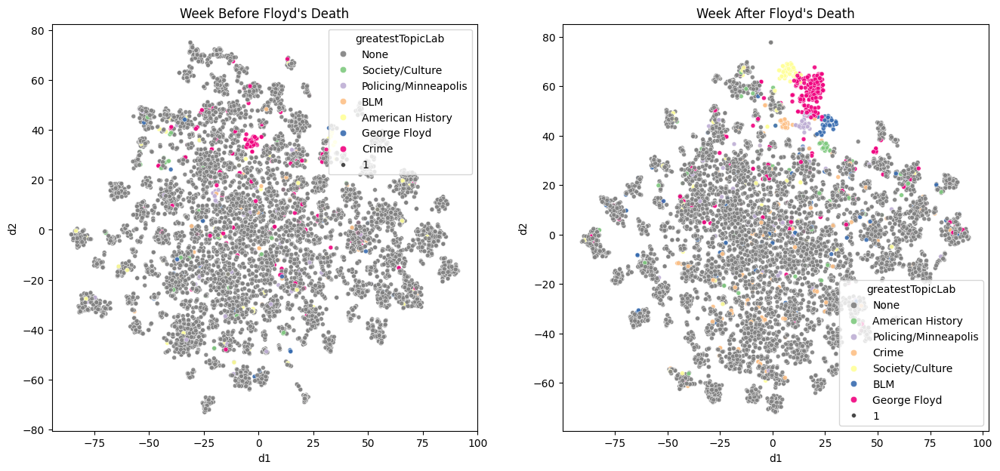

In [151]:
fig, axs = plt.subplots(1, 2, figsize=(16, 7))
pal = ['#7fc97f','#beaed4','#fdc086','#ffff99','#386cb0','#f0027f','#bf5b17']
sns.scatterplot(data=beforeSamp, x="d1", y="d2", hue="greatestTopicLab", palette=["grey"] + pal, size=1, alpha=.9, ax=axs[0])
axs[0].set_title("Week Before Floyd's Death")

sns.scatterplot(data=afterSamp, x="d1", y="d2", hue="greatestTopicLab", palette=["grey"] + pal, size=1, alpha=.9, ax=axs[1])
axs[1].set_title("Week After Floyd's Death")